In [ ]:
!git clone https://github.com/Yaswanth-B/AccessibleLLM.git

In [ ]:
!pip install git+https://github.com/huggingface/transformers.git
!pip install bert-score torch transformers

In [ ]:
import zipfile
import os

# Path to the uploaded zip file
zip_path = '/content/AccessibleLLM/object detection/FlickrDS.zip'

# Directory to extract to
extract_path = '/content/AccessibleLLM/object detection/FlickrDS'

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

os.listdir(extract_path)

['FlickrDS']

In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [ ]:
import requests #Allows you to send HTTP requests easily in Python.
import numpy as np
import PIL # PIL (or its fork Pillow) is used for opening, manipulating, and saving many different image file formats in Python.
import io
import html
import time
from base64 import b64decode, b64encode
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
import cv2
import torch
from transformers import BertTokenizer, BertForSequenceClassification
import bert_score

In [ ]:
from transformers import AutoProcessor, Blip2ForConditionalGeneration
import torch

processor = AutoProcessor.from_pretrained("Salesforce/blip2-opt-2.7b")
model = Blip2ForConditionalGeneration.from_pretrained("Salesforce/blip2-opt-2.7b", torch_dtype=torch.float16)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

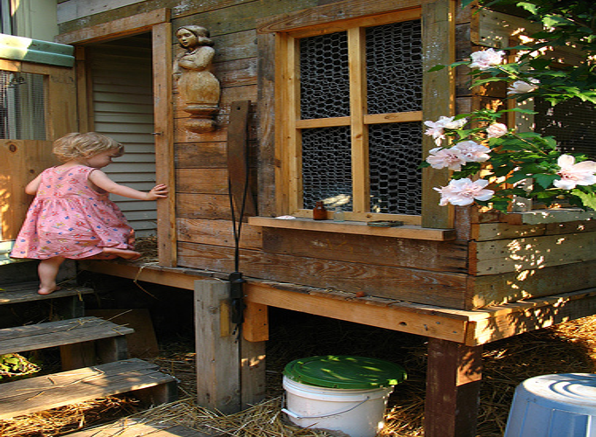

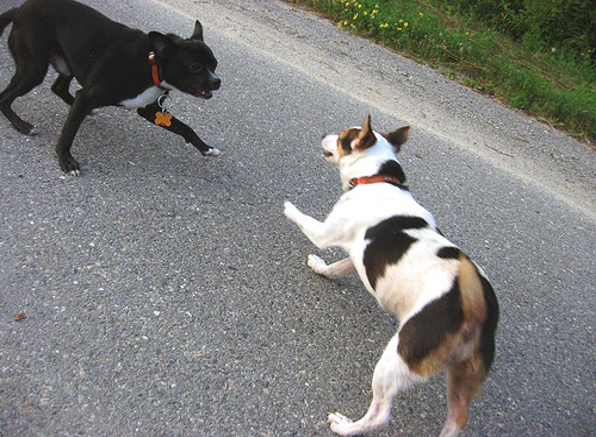

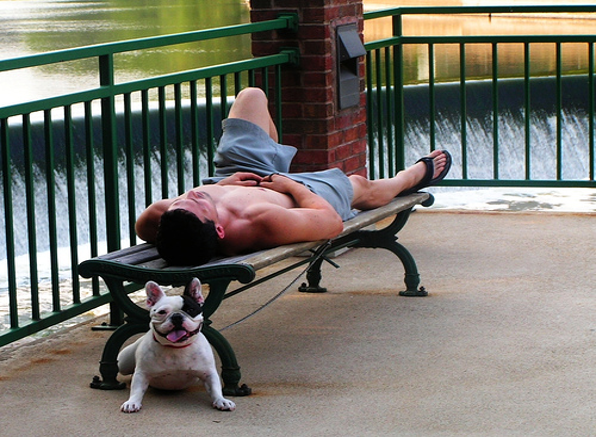

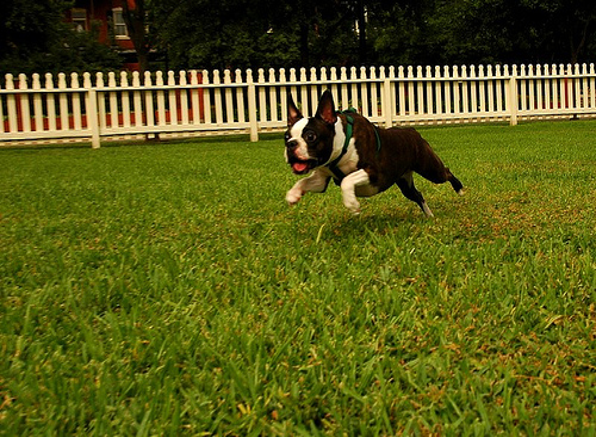

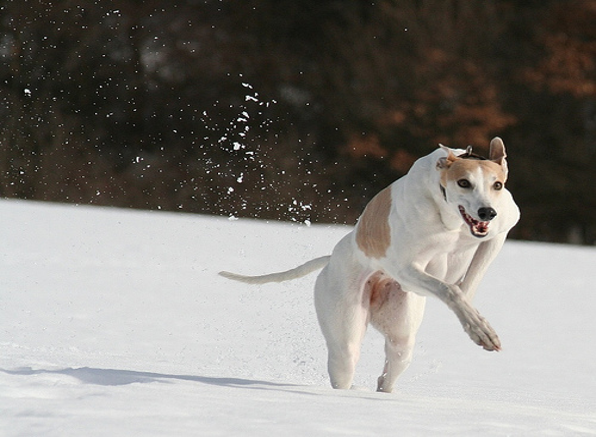

...

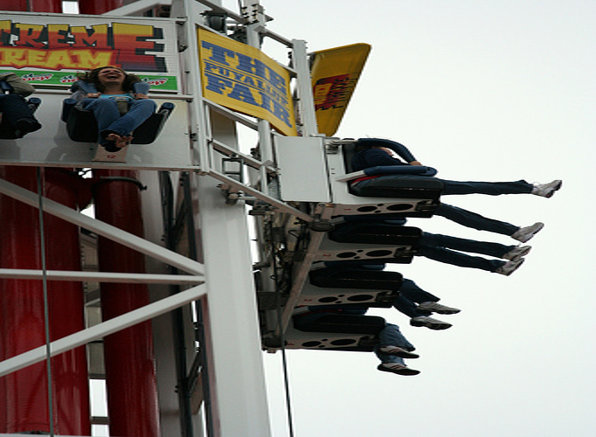

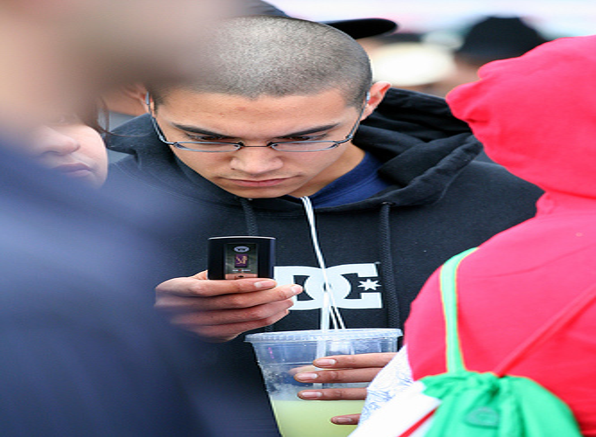

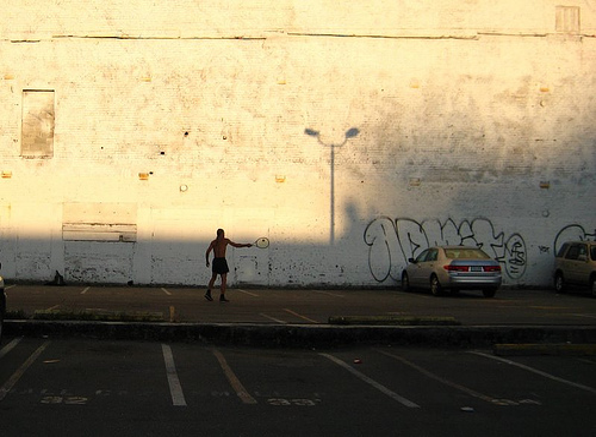

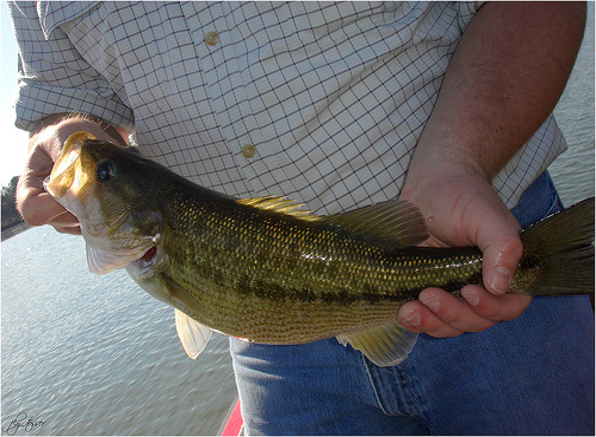

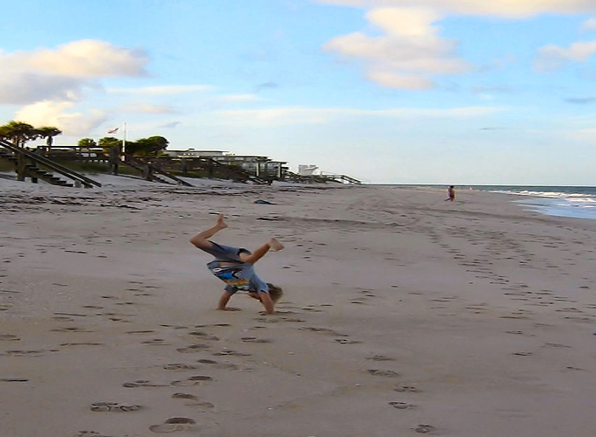

In [ ]:
import os
from PIL import Image

with open("generated_captions.txt", "w") as file:
    for image_number in range(1, 46):
        image_path = f"/content/AccessibleLLM/object detection/FlickrDS/FlickrDS/photosFDS/{image_number}.jpg"

        if os.path.exists(image_path):
            image = Image.open(image_path).convert('RGB')
            image = image.resize((596, 437))
            display(image)

            inputs = processor(image, return_tensors="pt").to(device, torch.float32)

            generated_ids = model.generate(**inputs, max_length=50, min_length=20)
            generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0].strip()

            file.write(f"{generated_text}\n")
        else:
            file.write(f"Image {image_number} file not found.\n")


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification
import bert_score

# Sample captions generated by BLIP-2 MOdel
with open("/content/generated_captions.txt", "r") as file:
    model1_text = file.read()

blip2_text = model1_text.strip().split('\n')

# Sample reference captions (ground truth)
with open("/content/AccessibleLLM/object detection/FlickrDS/FlickrDS/captionsDS.txt", "r") as file:
    references_text = file.read()

true_text = references_text.strip().split('\n')

# Compute BERTScore for BLIP-2 Model
P_A, R_A, F1_A = bert_score.score(
    blip2_text,
    true_text,
    lang='en',  # Language of the captions (e.g., 'en' for English)
    model_type='bert-base-uncased',  # BERT model type
    verbose=True  # Print progress
)

print("BERTScore for BLIP-2 Model:")
print(f"Precision: {P_A.mean():.4f}")
print(f"Recall: {R_A.mean():.4f}")
print(f"F1-score: {F1_A.mean():.4f}")

calculating scores...
computing bert embedding.


  0%|          | 0/2 [00:00<?, ?it/s]

computing greedy matching.


  0%|          | 0/1 [00:00<?, ?it/s]

done in 0.36 seconds, 126.34 sentences/sec
BERTScore for BLIP-2 Model:
Precision: 0.5858
Recall: 0.6587
F1-score: 0.6184
